<a href="https://colab.research.google.com/github/Jtwulf/Interaction2023_manuscript/blob/main/diff_spec.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import Audio

In [3]:
audio = "/content/drive/MyDrive/B3 ウルフ/songs/3 Years On/01 - So Sweet.mp3"
y, sr = librosa.load(audio)
N = 16

In [8]:
def split_by_beats():
  tempo, beat_frames = librosa.beat.beat_track(y=y, sr=sr)
  beats = librosa.frames_to_time(beat_frames, sr=sr)
  beat_length = np.mean(np.diff(beats))
  segment_length = beat_length * N * 2

  segments = []
  for i in range(0, len(y), int(segment_length * sr)):
    segment = y[i:i + int(segment_length * sr)]
    if len(segment) == int(segment_length * sr):
      segments.append(segment)
  return segments

def plot_and_play_segments(segments):
  for i, segment in enumerate(segments):
    plt.subplot(10, 1, 1)
    librosa.display.waveshow(segment, sr=sr)
    display(Audio(segment, rate=sr))
    plt.title(f'Segment {i+1}')
    plt.show()

def calc_diff_spec(segment1, segment2, sr=sr):
    spec1 = np.abs(librosa.stft(segment1, n_fft=2048, hop_length=512))
    spec2 = np.abs(librosa.stft(segment2, n_fft=2048, hop_length=512))
    return spec2 - spec1

def plot_and_play_diff_spec(diff_spec, sr=sr):
    librosa.display.specshow(librosa.amplitude_to_db(diff_spec, ref=np.max),
                             sr=sr, hop_length=512, y_axis='linear', x_axis='time')
    plt.colorbar(format='%+2.0f dB')
    plt.title("diff spec")
    plt.show()

    diff_audio = librosa.istft(diff_spec, hop_length=512)
    display(Audio(diff_audio, rate=sr))

#作ってもらったやつ
def time_shift(audio, sr, shift):
    samples_shift = int(shift * sr)
    if samples_shift >= 0:
        audio_shifted = np.concatenate((audio[samples_shift:], np.zeros(samples_shift)))
    else:
        audio_shifted = np.concatenate((np.zeros(abs(samples_shift)), audio[:samples_shift]))
    return audio_shifted

0.0


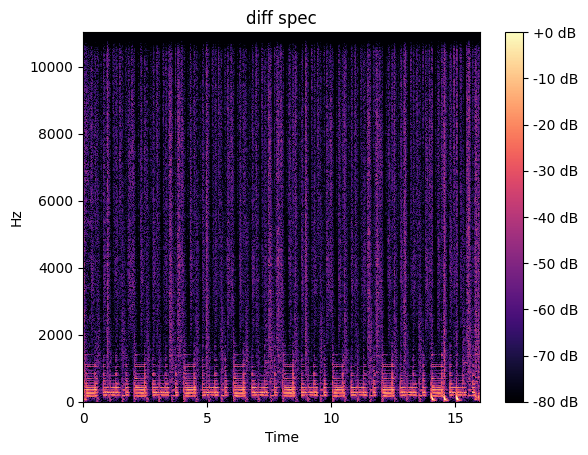

0.001


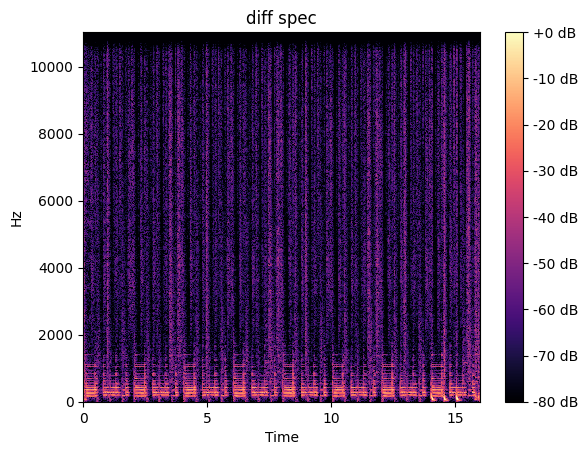

0.002


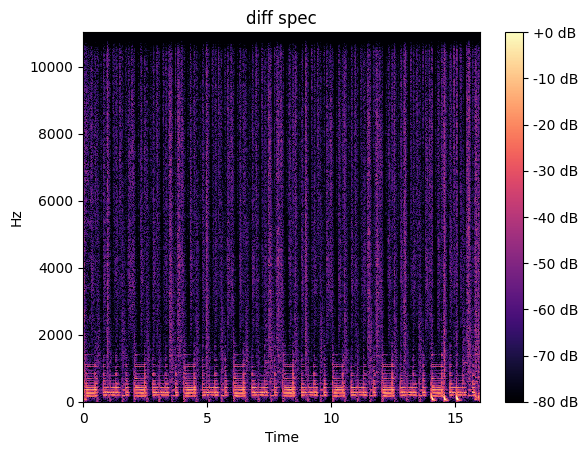

0.003


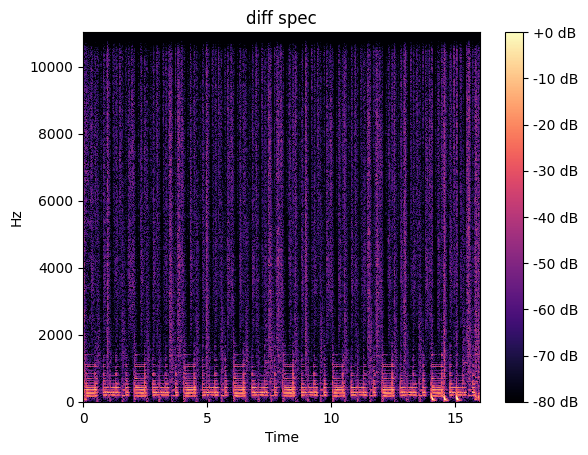

0.004


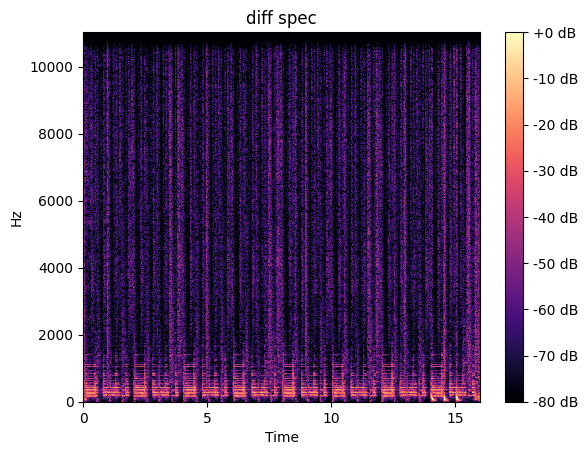

0.005


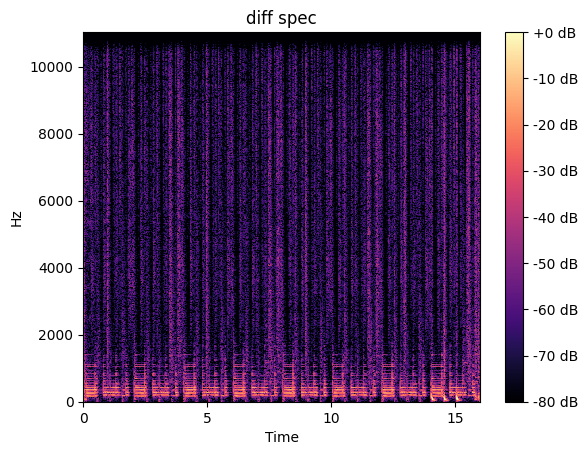

0.006


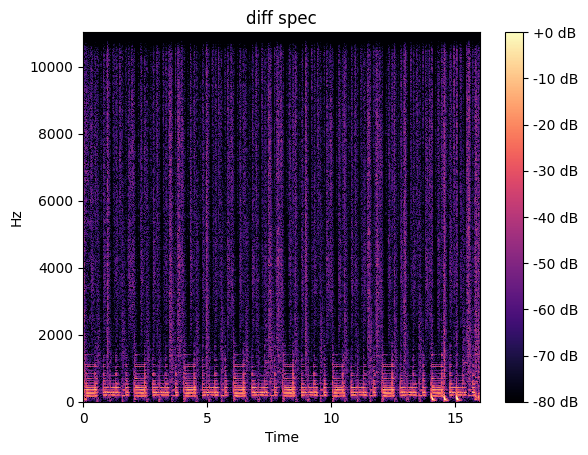

0.007


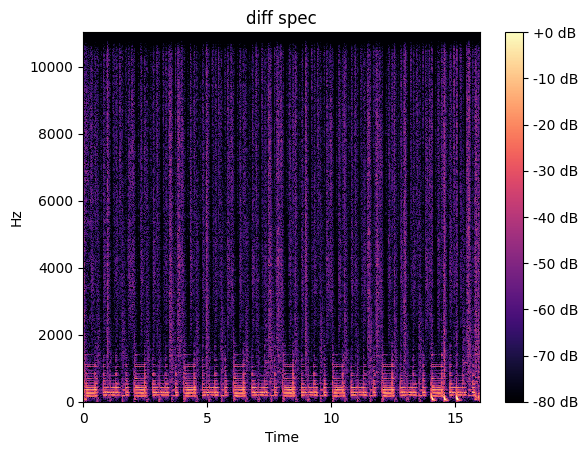

0.008


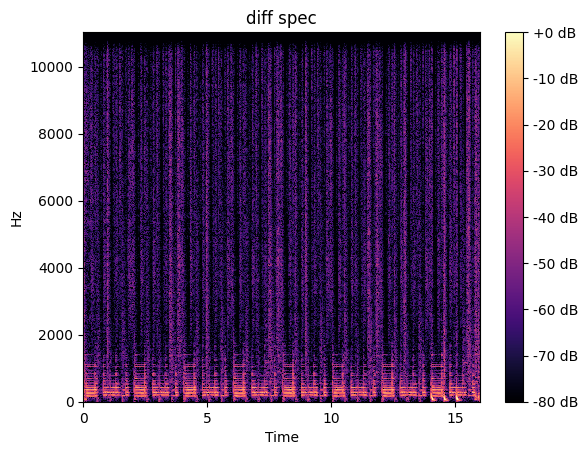

0.009


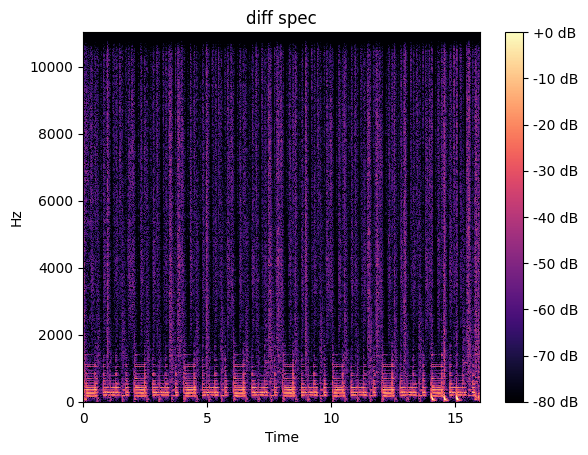

0.01


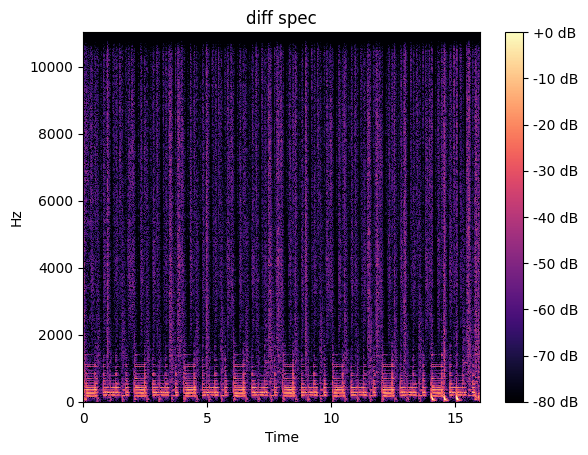

0.011


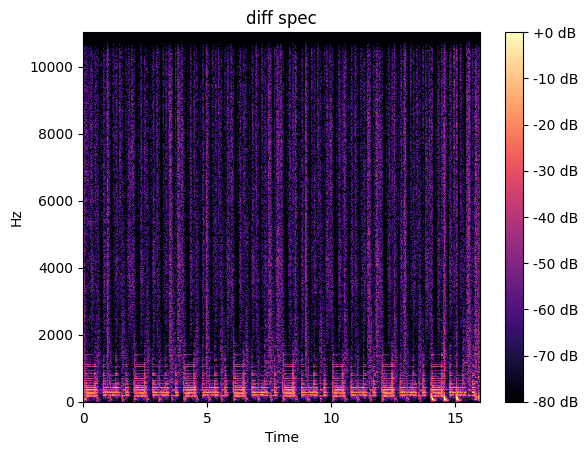

0.012


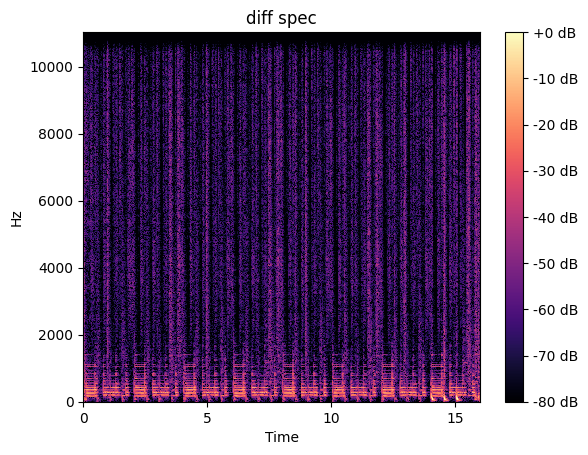

0.013


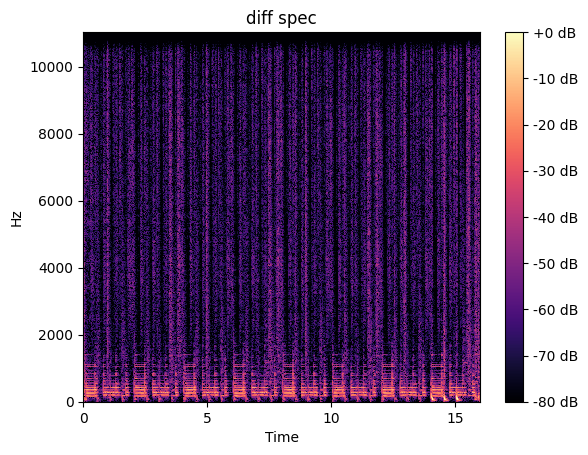

0.014


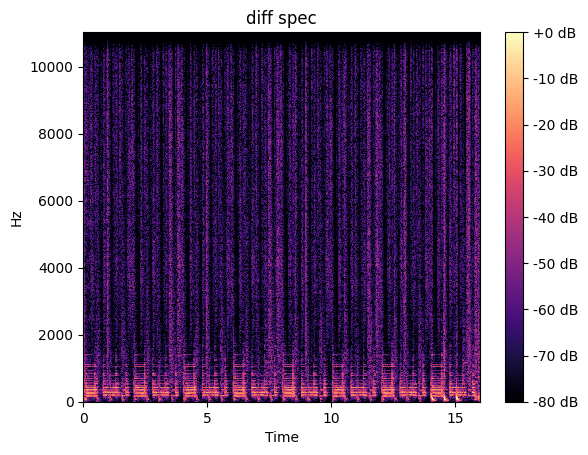

0.015


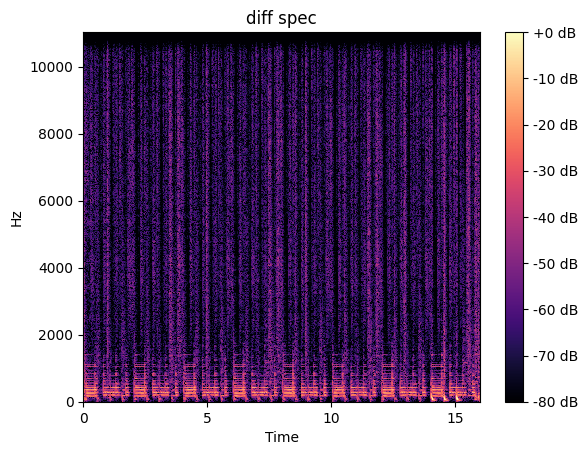

0.016


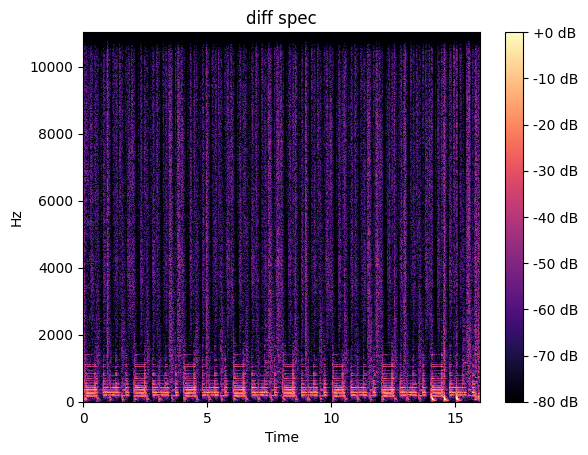

0.017


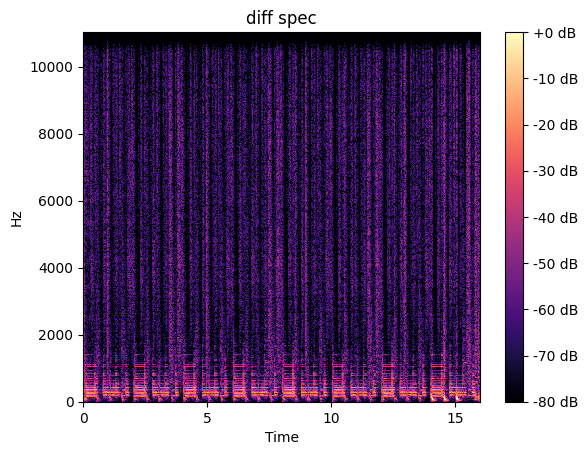

In [ ]:
segments = split_by_beats()
#plot_and_play_segments(segments)

#segment2を0.001秒間隔で後にずらす
for i in range(50):
  shifted_segments = [segments[0], time_shift(segments[1], sr, i/10000)]
  print(i/1000)
  diff_spec = calc_diff_spec(shifted_segments[0], shifted_segments[1])
  plot_and_play_diff_spec(diff_spec, sr=sr)

#segment2を0.001秒間隔で前にずらす
for i in range(50):
  shifted_segments = [segments[0], time_shift(segments[1], sr, -i/10000)]
  print(-i/1000)
  diff_spec = calc_diff_spec(shifted_segments[0], shifted_segments[1])
  plot_and_play_diff_spec(diff_spec, sr=sr)
